In [2]:
import matplotlib.pyplot as plt
from sklearn import datasets
import plotly.express as px
import pandas as pd

## `annotation`

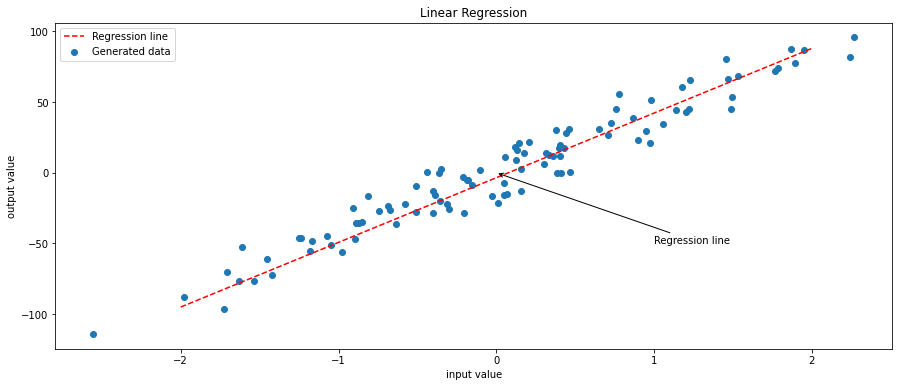

In [5]:

x, y, _ = datasets.make_regression(n_samples=100, n_features=1, noise=10, coef=True, random_state=0)

plt.plot([-2,2],[-95, 88], c='r', ls='--', label="Regression line")
plt.scatter(x,y, label="Generated data")
plt.title("Linear Regression")
plt.legend()
plt.xlabel("input value")
plt.ylabel("output value")
plt.annotate("Regression line", (0,0), (1,-50), arrowprops={"arrowstyle":"->"})

fig = plt.gcf()
fig.set_figwidth(15)
fig.set_figheight(6)

## subplots

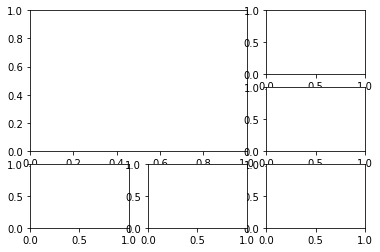

In [7]:
fig = plt.figure()
gs = fig.add_gridspec(3, 3)
ax1 = fig.add_subplot(gs[:2,:-1])
ax2 = fig.add_subplot(gs[0,-1])
ax3 = fig.add_subplot(gs[1,-1])
ax4 = fig.add_subplot(gs[2,-1])
ax5 = fig.add_subplot(gs[2,0])
ax6 = fig.add_subplot(gs[2,1])

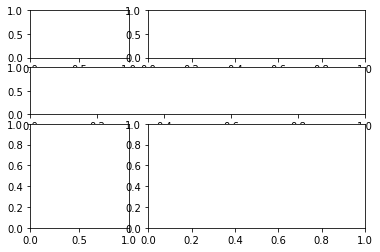

In [8]:
fig = plt.figure()
gs = fig.add_gridspec(4, 3)
ax1 = fig.add_subplot(gs[0,0])
ax2 = fig.add_subplot(gs[0,1:3])
ax3 = fig.add_subplot(gs[1,:])
ax4 = fig.add_subplot(gs[2:,0])
ax5 = fig.add_subplot(gs[2:,1:])

## seabron

In [77]:
import pandas as pd
import seaborn as sns

df = sns.load_dataset('tips')
df.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


### Counting number of datapoints

In [11]:
sns.color_palette()

[(0.12156862745098039, 0.4666666666666667, 0.7058823529411765),
 (1.0, 0.4980392156862745, 0.054901960784313725),
 (0.17254901960784313, 0.6274509803921569, 0.17254901960784313),
 (0.8392156862745098, 0.15294117647058825, 0.1568627450980392),
 (0.5803921568627451, 0.403921568627451, 0.7411764705882353),
 (0.5490196078431373, 0.33725490196078434, 0.29411764705882354),
 (0.8901960784313725, 0.4666666666666667, 0.7607843137254902),
 (0.4980392156862745, 0.4980392156862745, 0.4980392156862745),
 (0.7372549019607844, 0.7411764705882353, 0.13333333333333333),
 (0.09019607843137255, 0.7450980392156863, 0.8117647058823529)]

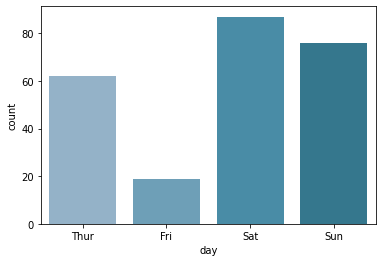

In [12]:
with sns.color_palette("PuBuGn_d"):
    sns.countplot(data = df, x='day', 
                  order=['Thur', 'Fri', 'Sat', 'Sun'])

<AxesSubplot:xlabel='day', ylabel='count'>

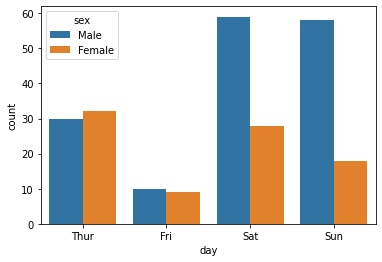

In [13]:
sns.countplot(data=df,
              x="day",
             hue="sex")

### Distribution

<AxesSubplot:xlabel='tip', ylabel='Count'>

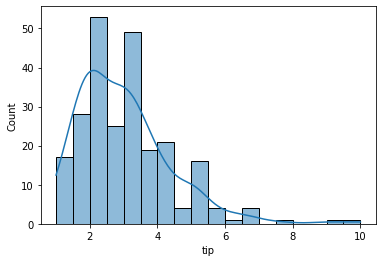

In [16]:
## overlay 'kernel density estimator'
sns.histplot(df.tip, kde=True) 

#### Multiple distribution

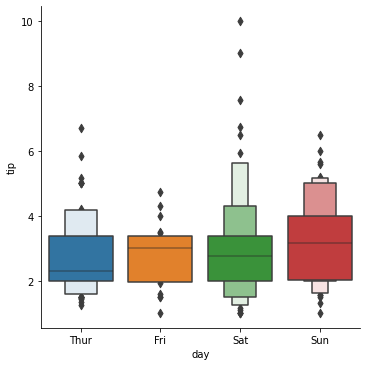

In [17]:
sns.catplot(data=df, x='day', y='tip', kind='boxen')

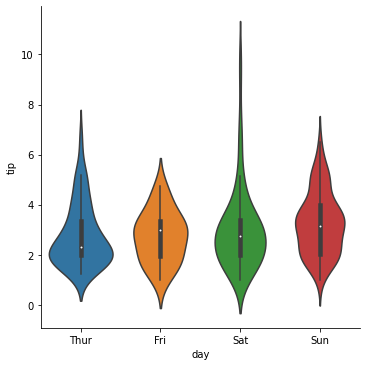

In [18]:
sns.catplot(data=df, x='day', y='tip', 
            kind='violin')

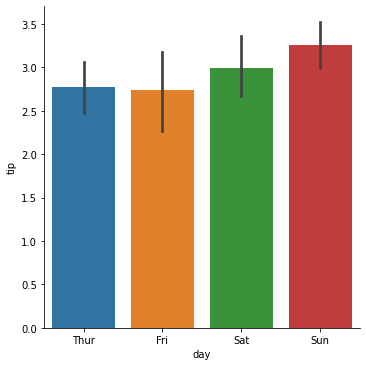

In [19]:
sns.catplot(data=df, x='day', y='tip', 
            kind='bar')

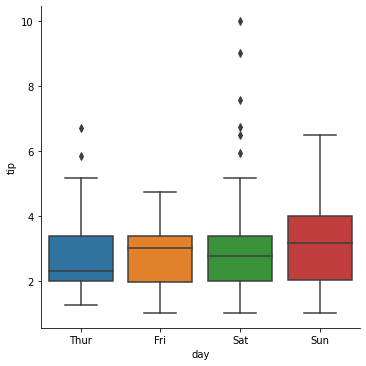

In [20]:
sns.catplot(data=df, x='day', y='tip', 
            kind='box')

In [79]:
df["tip_share"]=round(df.tip / df.total_bill * 100, 2)

[Text(0, 0.5, 'Tip (%)')]

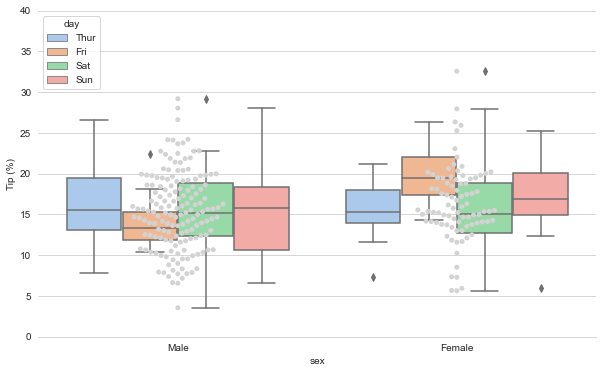

In [82]:
# PLOT HERE
sns.set_style('whitegrid')
fig, ax = plt.subplots(figsize=(10,6))
sns.swarmplot(x="sex",
              y="tip_share",
              data=df,
              color='lightgray',
              size=5, 
              ax=ax)

sns.boxplot(x='sex', 
            y = 'tip_share', 
            hue = 'day', 
            hue_order=["Thur", "Fri", "Sat", "Sun"], 
            data = df, 
            palette="pastel", 
            ax=ax)

sns.despine(top=True,left=True,right=True)
ax.set(ylim=(0, 40))
ax.set(ylabel="Tip (%)")

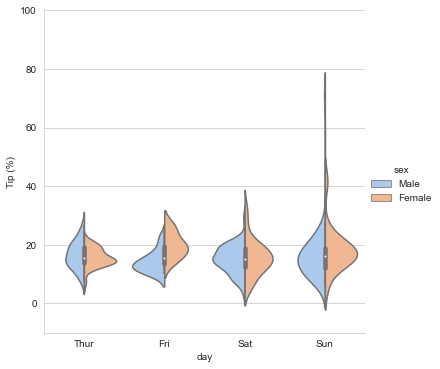

In [84]:
# YOUR PLOT HERE
sns.set_style('whitegrid')
g = sns.catplot(x='day',
                y ='tip_share', 
                hue ='sex',
                order=["Thur", "Fri", "Sat", "Sun"],
                data = df, 
                kind= "violin", 
                palette="pastel", 
                split=True)
g.set_ylabels("Tip (%)")
g.set(ylim=(-10, 100))

### FacetGrid 

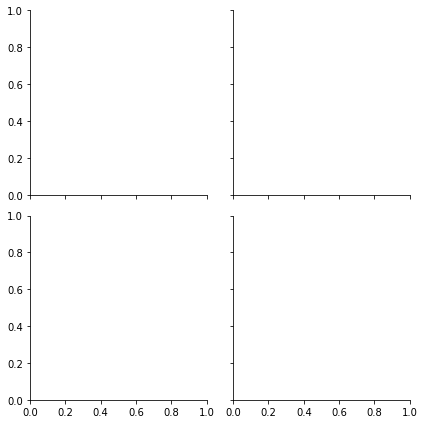

In [22]:
sns.FacetGrid(df, col="time", row="sex")

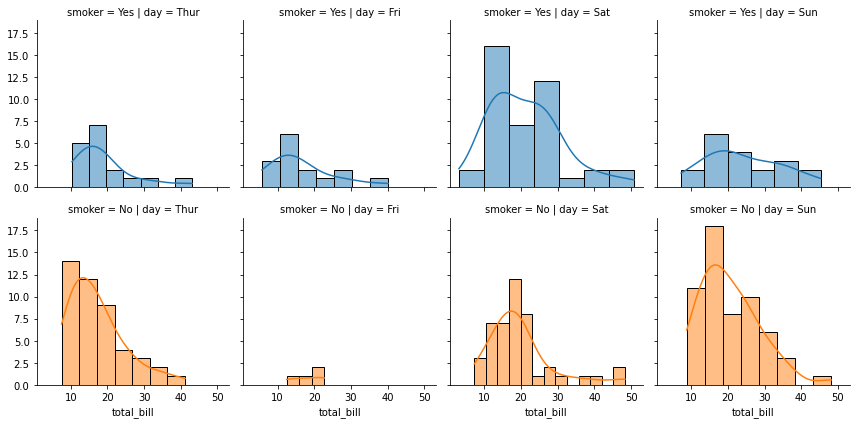

In [26]:
g = sns.FacetGrid(df, col="day", row="smoker", hue='smoker')
g.map(sns.histplot, "total_bill", kde=True)

## Correlations

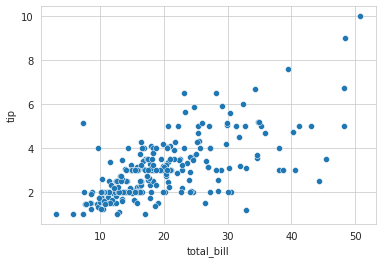

In [27]:
with sns.axes_style(style="whitegrid"):
    sns.scatterplot(x="total_bill", y="tip", data=df)

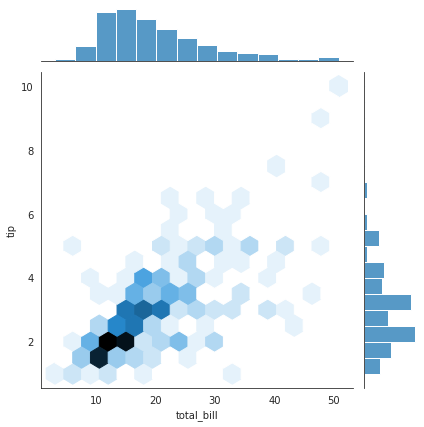

In [28]:
with sns.axes_style("white"):
    sns.jointplot(x="total_bill", y="tip", kind="hex", data=df)

<AxesSubplot:xlabel='total_bill', ylabel='tip'>

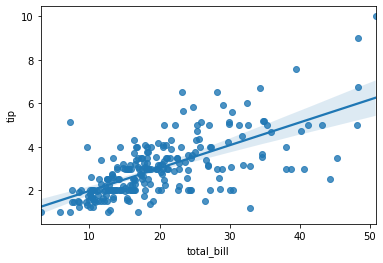

In [29]:
sns.regplot(x="total_bill", y="tip", data=df)

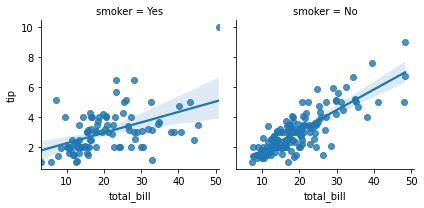

In [30]:
g = sns.FacetGrid(data=df, col="smoker")
g.map(sns.regplot, "total_bill", "tip")

## Pairplot

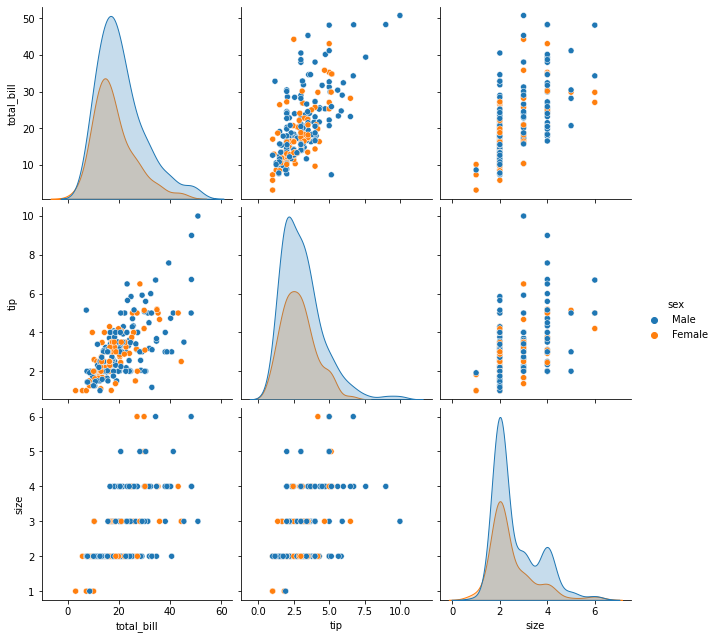

In [40]:
sns.pairplot(df, height=3, hue="sex")

## Lollipop plot

Text(0, 0.5, 'Group')

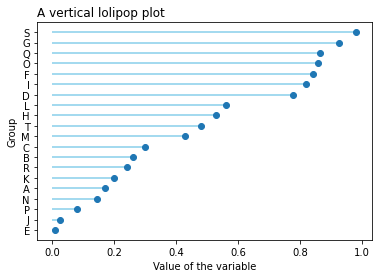

In [1]:
# libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
 
# Create a dataframe
df = pd.DataFrame({'group':list(map(chr, range(65, 85))), 'values':np.random.uniform(size=20) })
 
# Reorder it following the values:
ordered_df = df.sort_values(by='values')
my_range=range(1,len(df.index)+1)
 
# The vertival plot is made using the hline function
# I load the seaborn library only to benefit the nice looking feature
import seaborn as sns
plt.hlines(y=my_range, xmin=0, xmax=ordered_df['values'], color='skyblue')
plt.plot(ordered_df['values'], my_range, "o")
 
# Add titles and axis names
plt.yticks(my_range, ordered_df['group'])
plt.title("A vertical lolipop plot", loc='left')
plt.xlabel('Value of the variable')
plt.ylabel('Group')


In [2]:
df

,group,value1,value2
0,A,0.689921,0.840676
1,B,0.715561,0.751551
2,C,0.877635,0.978965
3,D,0.280519,0.431128
4,E,0.392855,0.598966
5,F,0.186247,0.191991
6,G,0.519938,0.718474
7,H,0.798652,0.956147
8,I,0.357393,0.385122
9,J,0.423419,0.651134


In [1]:
import pandas as pd
import numpy as np
import plotly.offline as pyo
import plotly.graph_objs as go

# Create a dataframe
value1 = np.random.uniform(size = 20)
value2 = value1 + np.random.uniform(size = 20) / 4
df = pd.DataFrame({'group':list(map(chr, range(65, 85))), 'value1':value1 , 'value2':value2 })

my_range=range(1,len(df.index)+1)

# Add title and axis names
data1 = go.Scatter(
        x=df['value1'],
        y=np.array(my_range),
        mode='markers',
        marker=dict(color='blue')
    )


data2 = go.Scatter(
        x=df['value2'],
        y=np.array(my_range),
        mode='markers',
        marker=dict(color='green')
    )

# Horizontal line shape
shapes=[dict(
        type='line',
        x0 = df['value1'].loc[i],
        y0 = i + 1,
        x1 = df['value2'].loc[i],
        y1 = i + 1,
        line = dict(
            color = 'grey',
            width = 2
        )
    ) for i in range(len(df['value1']))]


layout = go.Layout(
    shapes = shapes,
    title='Lollipop Chart'
)

# Plot the chart
fig = go.Figure([data1, data2], layout)

# pyo.plot(fig)
fig.show()

## Bubble chart

In [44]:
import plotly.express as px
df = px.data.gapminder()

fig = px.scatter(df.query("year==2007"), x="gdpPercap", y="lifeExp",
                 size="pop", color="continent",
                 hover_name="country", log_x=True, size_max=60)
fig.show()

In [45]:
import plotly.graph_objects as go
import plotly.express as px
import pandas as pd
import math

# Load data, define hover text and bubble size
data = px.data.gapminder()
df_2007 = data[data['year']==2007]
df_2007 = df_2007.sort_values(['continent', 'country'])

hover_text = []
bubble_size = []

for index, row in df_2007.iterrows():
    hover_text.append(('Country: {country}<br>'+
                      'Life Expectancy: {lifeExp}<br>'+
                      'GDP per capita: {gdp}<br>'+
                      'Population: {pop}<br>'+
                      'Year: {year}').format(country=row['country'],
                                            lifeExp=row['lifeExp'],
                                            gdp=row['gdpPercap'],
                                            pop=row['pop'],
                                            year=row['year']))
    bubble_size.append(math.sqrt(row['pop']))

df_2007['text'] = hover_text
df_2007['size'] = bubble_size
sizeref = 2.*max(df_2007['size'])/(100**2)

# Dictionary with dataframes for each continent
continent_names = ['Africa', 'Americas', 'Asia', 'Europe', 'Oceania']
continent_data = {continent:df_2007.query("continent == '%s'" %continent)
                              for continent in continent_names}

# Create figure
fig = go.Figure()

for continent_name, continent in continent_data.items():
    fig.add_trace(go.Scatter(
        x=continent['gdpPercap'], y=continent['lifeExp'],
        name=continent_name, text=continent['text'],
        marker_size=continent['size'],
        ))

# Tune marker appearance and layout
fig.update_traces(mode='markers', marker=dict(sizemode='area',
                                              sizeref=sizeref, line_width=2))

fig.update_layout(
    title='Life Expectancy v. Per Capita GDP, 2007',
    xaxis=dict(
        title='GDP per capita (2000 dollars)',
        gridcolor='white',
        type='log',
        gridwidth=2,
    ),
    yaxis=dict(
        title='Life Expectancy (years)',
        gridcolor='white',
        gridwidth=2,
    ),
    paper_bgcolor='rgb(243, 243, 243)',
    plot_bgcolor='rgb(243, 243, 243)',
)
fig.show()

## Map

In [2]:
import plotly.express as px
import pandas as pd

file="../data/FastFoodRestaurants.csv"
restaurant_df = pd.read_csv(file, decimal=",")

restaurant_df['latitude'] = restaurant_df['latitude'].astype(float)
restaurant_df['longitude'] = restaurant_df['longitude'].astype(float)

grouped_by_city = restaurant_df.groupby('city')


by_city_df = grouped_by_city.agg({
    'city' : 'count',
    'latitude' : 'mean',
    'longitude' : 'mean'
}).rename(columns={'city':'Nb of fastfoods'})

fig = px.scatter_geo(by_city_df, 
                     lat="latitude", 
                     lon="longitude", 
                     size="Nb of fastfoods", 
                     title="Fastfood Restaurants Accross the U.S.",
                     scope="usa"
                    )
fig.show()

In [3]:
file = "../data/Datafiniti_Fast_Food_Restaurants.csv"
restaurant_df = pd.read_csv(file, decimal=",")

restaurant_df['dateAdded'] = restaurant_df['dateAdded'].str.split('-').str[0]

restaurant_df['dateAdded'] = pd.to_datetime(restaurant_df['dateAdded'], format='%Y')
restaurant_df['dateAdded'] = restaurant_df['dateAdded'].dt.year
restaurant_df['dateAdded']

fig = px.scatter_geo(restaurant_df.sort_values(by=['dateAdded']), 
                     lat="latitude", 
                     lon="longitude",
                     hover_name="name",
                     animation_frame="dateAdded",
                     title="Evolution Of Fastfood Restaurants Accross the U.S.",
                     scope="usa",
                     opacity=0.3)
fig.show()

In [4]:
import plotly.graph_objects as go

import pandas as pd

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2011_february_us_airport_traffic.csv')
df['text'] = df['airport'] + '' + df['city'] + ', ' + df['state'] + '' + 'Arrivals: ' + df['cnt'].astype(str)

fig = go.Figure(data=go.Scattergeo(
        lon = df['long'],
        lat = df['lat'],
        text = df['text'],
        mode = 'markers',
        marker_color = df['cnt'],
        ))

fig.update_layout(
        title = 'Most trafficked US airports<br>(Hover for airport names)',
        geo_scope='usa',
    )
fig.show()

In [5]:
import plotly.express as px
px.set_mapbox_access_token(open("../mapbox_token").read())
df = px.data.carshare()
fig = px.scatter_mapbox(df, lat="centroid_lat", lon="centroid_lon", color="peak_hour", size="car_hours",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10)
fig.show()

### choropleth

In [1]:
import plotly.graph_objects as go

fig = go.Figure(go.Scattergeo())
fig.update_geos(
    visible=False, resolution=110, scope="usa",
    showcountries=True, countrycolor="black",
    showsubunits=True, subunitcolor="Blue"
)
fig.update_layout(height=300, margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [24]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

import plotly.express as px

fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [10]:
import plotly.express as px

df = px.data.election()
geojson = px.data.election_geojson()

fig = px.choropleth(df, 
                    geojson=geojson,
                    color="Bergeron",
                    locations="district", 
                    featureidkey="properties.district",
                    projection="mercator"
                   )
fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### `folium`

In [90]:
import folium

In [91]:
coordinates = [48.8649224, 2.3800903] # 16 Villa Gaudelet, Paris

m = folium.Map(location=coordinates, zoom_start=8)
folium.Marker(coordinates, tooltip='Le Wagon Paris').add_to(m)
folium.Circle(coordinates, radius=100 * 1000).add_to(m)
m

In [92]:
import requests

def geocode(address):
    params = { "q": address, 'format': 'json' }
    places = requests.get(f"https://nominatim.openstreetmap.org/search", params=params).json()
    return [places[0]['lat'], places[0]['lon']]
    
def draw_100km_map(address):
    coordinates = geocode(address)
    m = folium.Map(location=coordinates, zoom_start=8)
    folium.Marker(coordinates, tooltip='Le Wagon Paris').add_to(m)
    folium.Circle(coordinates, radius=100 * 1000).add_to(m)
    return m

In [94]:
address = input()
draw_100km_map(address)

Amsterdam 1097 JR, the Netherlands


### Filter traces

In [8]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import datetime

# mimic OP's datasample

NPERIODS = 200

np.random.seed(123)
df = pd.DataFrame(np.random.randint(-10, 12, size=(NPERIODS, 4)),
                  columns=list('ABCD'))
datelist = pd.date_range(datetime.datetime(2020, 1, 1).strftime('%Y-%m-%d'),
                         periods=NPERIODS).tolist()
df['dates'] = datelist 
df = df.set_index(['dates'])
df.index = pd.to_datetime(df.index)
df.iloc[0] = 0
df = df.cumsum()

# # plotly
fig = go.Figure()

# set up ONE trace
fig.add_trace(go.Scatter(x=df.index,
                         y=df[df.columns[0]],
                         visible=True)
             )

updatemenu = []
buttons = []

# button with one option for each dataframe
for col in df.columns:
    buttons.append(dict(method='restyle',
                        label=col,
                        visible=True,
                        args=[{'y':[df[col]],
                               'x':[df.index],
                               'type':'scatter'},[0]],
                        )
                  )

# some adjustments to the updatemenus
updatemenu = []
your_menu = dict()
updatemenu.append(your_menu)

updatemenu[0]['buttons'] = buttons
updatemenu[0]['direction'] = 'down'
updatemenu[0]['showactive'] = True

# add dropdown menus to the figure
fig.update_layout(showlegend=False, updatemenus=updatemenu)
fig.show()

In [9]:
df

,A,B,C,D
dates,,,,
2020-01-01,0,0,0,0
2020-01-02,7,9,0,-9
2020-01-03,-3,16,5,-10
2020-01-04,-13,20,-5,-5
2020-01-05,-4,24,-11,-15
...,...,...,...,...
2020-07-14,114,30,66,148
2020-07-15,121,39,74,145
2020-07-16,126,45,70,137


## Bar Plot

In [68]:
file="data/bar_data.csv"
df=pd.read_csv(file)
df.head()

,year,sex,name,n,prop
0,1880,F,Helen,636,0.006516
1,1880,F,Amanda,241,0.002469
2,1880,F,Betty,117,0.001199
3,1880,F,Dorothy,112,0.001147
4,1880,F,Linda,27,0.000277


<AxesSubplot:xlabel='name'>

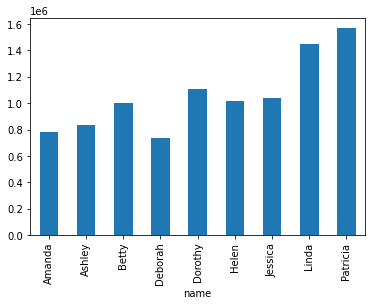

In [69]:
df.groupby(['name'])['n'].sum().plot(kind="bar")

In [70]:
# 1920, 1960, 2000
y1920 = df['year'] == 1920
y1960 = df['year'] == 1960
y2000 = df['year'] == 2000
y_selection = (y1920 | y1960 | y2000)

name1 = df['name'] == 'Ashley'
name2 = df['name'] == 'Betty'
name3 = df['name'] == 'Helen'
name4 = df['name'] == 'Patricia'
name_selection = (name1 | name2 | name3 | name4)

selection = (y_selection & name_selection)
df_extract = df[selection]
df_extract = df_extract.sort_values('name', ascending=True)

In [73]:
df_extract

,year,sex,name,n,prop
665,1960,F,Ashley,57,0.000027
1017,2000,F,Ashley,17997,0.009023
319,1920,F,Betty,14017,0.011267
660,1960,F,Betty,6503,0.003127
1025,2000,F,Betty,174,0.000087
318,1920,F,Helen,35098,0.028213
662,1960,F,Helen,4069,0.001956
1021,2000,F,Helen,890,0.000446
320,1920,F,Patricia,2502,0.002011
658,1960,F,Patricia,32107,0.015437


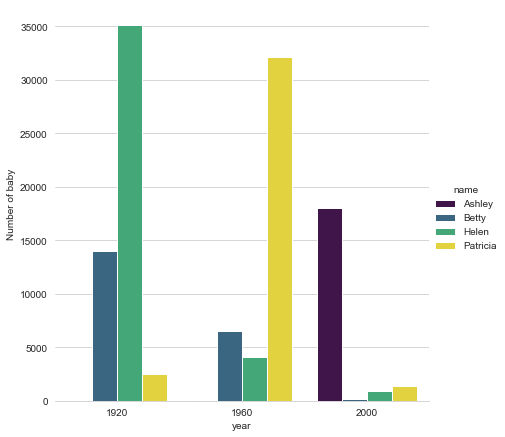

In [74]:
colors = ['#440c53','#2f688e','#34b779','#fde825']
sns.set_style('whitegrid')
g = sns.catplot(x="year", y="n", hue="name", data=df_extract,
                height=6, kind="bar", 
                palette=sns.color_palette(colors))
g.despine(left=True)
g.set_ylabels("Number of baby")

<AxesSubplot:xlabel='year'>

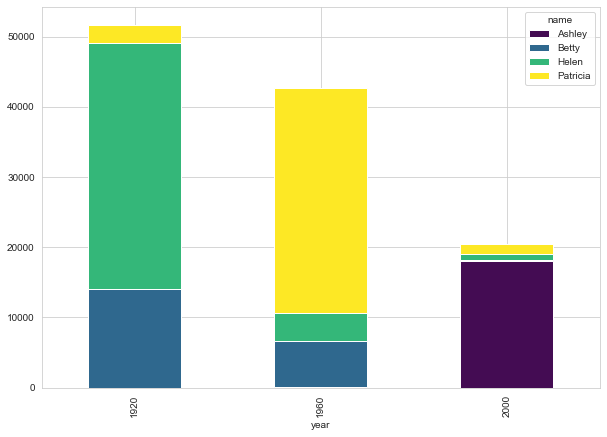

In [75]:
df_pivot = df_extract[['year','name','n']]
df_pivot = df_pivot.pivot(index='year', columns='name', values='n')
df_pivot.loc[:,['Ashley','Betty', 'Helen', 'Patricia']].plot.bar(stacked=True, color=colors, figsize=(10,7))

In [76]:
df_pivot

name,Ashley,Betty,Helen,Patricia
year,,,,
1920,NaN,14017.0,35098.0,2502.0
1960,57.0,6503.0,4069.0,32107.0
2000,17997.0,174.0,890.0,1392.0


## Ridgeplot

/Users/moyang/.pyenv/versions/3.8.5/envs/projectweb/lib/python3.8/site-packages/seaborn/axisgrid.py:64: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations

/Users/moyang/.pyenv/versions/3.8.5/envs/projectweb/lib/python3.8/site-packages/seaborn/axisgrid.py:64: UserWarning:

Tight layout not applied. tight_layout cannot make axes height small enough to accommodate all axes decorations



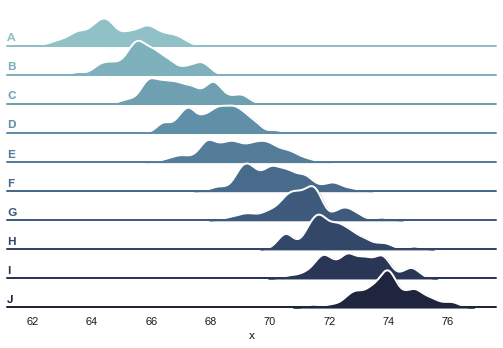

In [86]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
sns.set_theme(style="white", rc={"axes.facecolor": (0, 0, 0, 0)})

# Create the data
rs = np.random.RandomState(1979)
x = rs.randn(500)
g = np.tile(list("ABCDEFGHIJ"), 50)
df = pd.DataFrame(dict(x=x, g=g))
m = df.g.map(ord)
df["x"] += m

# Initialize the FacetGrid object
pal = sns.cubehelix_palette(10, rot=-.25, light=.7)
g = sns.FacetGrid(df, row="g", hue="g", aspect=15, height=.5, palette=pal)

# Draw the densities in a few steps
g.map(sns.kdeplot, "x",
      bw_adjust=.5, clip_on=False,
      fill=True, alpha=1, linewidth=1.5)
g.map(sns.kdeplot, "x", clip_on=False, color="w", lw=2, bw_adjust=.5)
g.map(plt.axhline, y=0, lw=2, clip_on=False)


# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color,
            ha="left", va="center", transform=ax.transAxes)


g.map(label, "x")

# Set the subplots to overlap
g.fig.subplots_adjust(hspace=-.25)

# Remove axes details that don't play well with overlap
g.set_titles("")
g.set(yticks=[])
g.despine(bottom=True, left=True)

## filter data through buttons

In [9]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import datetime

# mimic OP's datasample

NPERIODS = 200

np.random.seed(123)
df = pd.DataFrame(np.random.randint(-10, 12, size=(NPERIODS, 4)),
                  columns=list('ABCD'))
datelist = pd.date_range(datetime.datetime(2020, 1, 1).strftime('%Y-%m-%d'),
                         periods=NPERIODS).tolist()
df['dates'] = datelist 
df = df.set_index(['dates'])
df.index = pd.to_datetime(df.index)
df.iloc[0] = 0
df = df.cumsum()

# # plotly
fig = go.Figure()

# set up ONE trace
fig.add_trace(go.Scatter(x=df.index,
                         y=df[df.columns[0]],
                         visible=True)
             )

updatemenu = []
buttons = []

# button with one option for each dataframe
for col in df.columns:
    buttons.append(dict(method='restyle',
                        label=col,
                        visible=True,
                        args=[{'y':[df[col]],
                               'x':[df.index]}]
                        )
                  )

# some adjustments to the updatemenus
updatemenu = []
your_menu = dict()
updatemenu.append(your_menu)

updatemenu[0]['buttons'] = buttons
updatemenu[0]['direction'] = 'down'
updatemenu[0]['showactive'] = True

# add dropdown menus to the figure
fig.update_layout(showlegend=False, updatemenus=updatemenu)
fig.show()

## Interactive Data Analysis

In [10]:
import datetime
import numpy as np
import pandas as pd

import plotly.graph_objects as go
from ipywidgets import widgets

In [11]:
df = pd.read_csv(
    'https://raw.githubusercontent.com/yankev/testing/master/datasets/nycflights.csv')
df = df.drop(df.columns[[0]], axis=1)

In [12]:
month = widgets.IntSlider(
    value=1.0,
    min=1.0,
    max=12.0,
    step=1.0,
    description='Month:',
    continuous_update=False
)

use_date = widgets.Checkbox(
    description='Date: ',
    value=True,
)
container = widgets.HBox(children=[use_date, month])


In [14]:
textbox = widgets.Dropdown(
    description='Airline:   ',
    value='DL',
    options=df['carrier'].unique().tolist()
)

origin = widgets.Dropdown(
    options=list(df['origin'].unique()),
    value='LGA',
    description='Origin Airport:',
)

In [15]:
# Assign an empty figure widget with two traces
trace1 = go.Histogram(x=df['arr_delay'], opacity=0.75, name='Arrival Delays')
trace2 = go.Histogram(x=df['dep_delay'], opacity=0.75, name='Departure Delays')
g = go.FigureWidget(data=[trace1, trace2],
                    layout=go.Layout(
                        title=dict(
                            text='NYC FlightDatabase'
                        ),
                        barmode='overlay'
                    ))

In [16]:
def validate():
    if origin.value in df['origin'].unique() and textbox.value in df['carrier'].unique():
        return True
    else:
        return False


def response(change):
    if validate():
        if use_date.value:
            filter_list = [i and j and k for i, j, k in
                           zip(df['month'] == month.value, df['carrier'] == textbox.value,
                               df['origin'] == origin.value)]
            temp_df = df[filter_list]

        else:
            filter_list = [i and j for i, j in
                           zip(df['carrier'] == 'DL', df['origin'] == origin.value)]
            temp_df = df[filter_list]
        x1 = temp_df['arr_delay']
        x2 = temp_df['dep_delay']
        with g.batch_update():
            g.data[0].x = x1
            g.data[1].x = x2
            g.layout.barmode = 'overlay'
            g.layout.xaxis.title = 'Delay in Minutes'
            g.layout.yaxis.title = 'Number of Delays'


origin.observe(response, names="value")
textbox.observe(response, names="value")
month.observe(response, names="value")
use_date.observe(response, names="value")

In [17]:
container2 = widgets.HBox([origin, textbox])
widgets.VBox([container,
              container2,
              g])

In [18]:
%%html
<img src = 'https://cloud.githubusercontent.com/assets/12302455/16637308/4e476280-43ac-11e6-9fd3-ada2c9506ee1.gif' >

## Treemap

In [4]:
df.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num,world
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4,world
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8,world
35,Algeria,Africa,2007,72.301,33333216,6223.367465,DZA,12,world
47,Angola,Africa,2007,42.731,12420476,4797.231267,AGO,24,world
59,Argentina,Americas,2007,75.320,40301927,12779.379640,ARG,32,world


In [7]:
import plotly.express as px
import numpy as np
df = px.data.gapminder().query("year == 2007")
df["world"] = "world" # in order to have a single root node
fig = px.treemap(df, path=['world', 'continent', 'country'], 
                 values='pop',
                  color='lifeExp', hover_data=['iso_alpha'],
#                   color_continuous_scale='RdBu',
                 
                  color_continuous_midpoint=np.average(df['lifeExp'],
                                                       weights=df['pop']
                                                      ))
fig.show()

In [15]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import pandas as pd

df = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/sales_success.csv')
print(df.head())

   Unnamed: 0 region   county salesperson  calls  sales
0           0  North   Dallam          JE     35     23
1           1  North   Dallam          ZQ     49     13
2           2  North   Dallam          IJ     20      6
3           3  North  Hartley          WE     39     37
4           4  North  Hartley          PL     42     37


In [16]:
levels = ['salesperson', 'county', 'region'] # levels used for the hierarchical chart
color_columns = ['sales', 'calls']
value_column = 'calls'

def build_hierarchical_dataframe(df, levels, value_column, color_columns=None):
    """
    Build a hierarchy of levels for Sunburst or Treemap charts.

    Levels are given starting from the bottom to the top of the hierarchy,
    ie the last level corresponds to the root.
    """
    df_all_trees = pd.DataFrame(columns=['id', 'parent', 'value', 'color'])
    for i, level in enumerate(levels):
        df_tree = pd.DataFrame(columns=['id', 'parent', 'value', 'color'])
        dfg = df.groupby(levels[i:]).sum()
        dfg = dfg.reset_index()
        df_tree['id'] = dfg[level].copy()
        if i < len(levels) - 1:
            df_tree['parent'] = dfg[levels[i+1]].copy()
        else:
            df_tree['parent'] = 'total'
        df_tree['value'] = dfg[value_column]
        df_tree['color'] = dfg[color_columns[0]] / dfg[color_columns[1]]
        df_all_trees = df_all_trees.append(df_tree, ignore_index=True)
    total = pd.Series(dict(id='total', parent='',
                              value=df[value_column].sum(),
                              color=df[color_columns[0]].sum() / df[color_columns[1]].sum()))
    df_all_trees = df_all_trees.append(total, ignore_index=True)
    return df_all_trees

In [19]:
df_all_trees = build_hierarchical_dataframe(df, levels, value_column, color_columns)
average_score = df['sales'].sum() / df['calls'].sum()
df_all_trees

,id,parent,value,color
0,AX,Houston,42,0.214286
1,BI,Hartley,24,0.333333
2,BS,Brewster,33,0.424242
3,DQ,Presidio,40,0.375000
4,DS,Duval,42,0.214286
...,...,...,...,...
68,East,total,407,0.393120
69,North,total,631,0.605388
70,South,total,381,0.506562
71,West,total,321,0.588785


In [14]:
fig = make_subplots(1, 2, specs=[[{"type": "domain"}, {"type": "domain"}]],)

fig.add_trace(go.Treemap(
    labels=df_all_trees['id'],
    parents=df_all_trees['parent'],
    values=df_all_trees['value'],
    branchvalues='total',
    marker=dict(
        colors=df_all_trees['color'],
        colorscale='RdBu',
        cmid=average_score),
    hovertemplate='<b>%{label} </b> <br> Sales: %{value}<br> Success rate: %{color:.2f}',
    name=''
    ), 1, 1)

fig.add_trace(go.Treemap(
    labels=df_all_trees['id'],
    parents=df_all_trees['parent'],
    values=df_all_trees['value'],
    branchvalues='total',
    marker=dict(
        colors=df_all_trees['color'],
        colorscale='RdBu',
        cmid=average_score),
    hovertemplate='<b>%{label} </b> <br> Sales: %{value}<br> Success rate: %{color:.2f}',
    maxdepth=2
    ), 1, 2)

fig.update_layout(margin=dict(t=20, b=10, r=10, l=10),
                 showlegend=True)
fig.show()

   Unnamed: 0 region   county salesperson  calls  sales
0           0  North   Dallam          JE     35     23
1           1  North   Dallam          ZQ     49     13
2           2  North   Dallam          IJ     20      6
3           3  North  Hartley          WE     39     37
4           4  North  Hartley          PL     42     37
